In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from nsrdb.utilities.statistics import mae_perc, mbe_perc

import cloud_classification as cc

sns.set(style="darkgrid")

In [ ]:
surfrad_meta = pd.read_csv('/projects/pxs/reference_grids/surfrad_meta.csv', index_col=0)
df = pd.read_csv(f'{cc.output_dir}/mlclouds_all_data_xgb_results.csv', index_col=0)

In [ ]:
df = df[df['mask_xgb']==1]
#df.columns.values.tolist()

In [3]:
df['flag'].unique()

array(['clear', 'bad_cloud', 'water_cloud', 'ice_cloud'], dtype=object)

In [4]:
df['nom_cloud_id'].unique()

array(['water', 'ice', 'clearsky'], dtype=object)

In [54]:
df['flag'].unique()

array(['clear', 'bad_cloud', 'water_cloud', 'ice_cloud'], dtype=object)

In [55]:
df['cloud_id_xgb'].unique()

array(['water', 'ice', 'clearsky'], dtype=object)

In [ ]:
df.to_csv(f'{cc.output_dir}/mlclouds_all_data_xgb_results.csv')

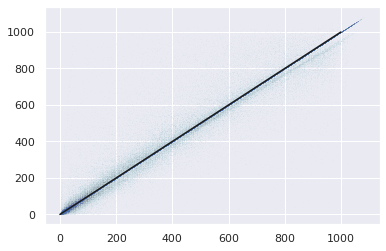

In [8]:
plt.scatter(df['xgb_results_ghi'], df['nom_ghi'], s=0.1, linewidth=0, alpha=0.1)
plt.plot([0, 1000], [0, 1000], c='k')

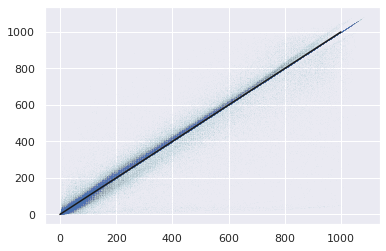

In [9]:
plt.scatter(df['xgb_results_ghi'], df['ghi'], s=0.1, linewidth=0, alpha=0.1)
plt.plot([0, 1000], [0, 1000], c='k')

In [10]:
stats = pd.DataFrame()
i = 0

for var in ('ghi', 'dni'):
    for model in ('nominal', 'uwisc', 'xgb'):
        if model == 'nominal':
            cloud_id_tag = 'nom_cloud_id'
        elif model == 'uwisc':
            cloud_id_tag = 'flag'
        else:
            cloud_id_tag = 'cloud_id_xgb'
        
        for condition in ('cloudy', 'clear', 'allsky'):
            cond_mask = df[cloud_id_tag].isin(('clearsky', 'clear'))
            if condition == 'cloudy':
                cond_mask = ~cond_mask
            elif condition == 'allsky':
                cond_mask = True
            
            for gid in df['gid'].unique():
                surfrad_name = surfrad_meta.loc[gid, 'surfrad_id']
                mask = cond_mask & (df['gid'] == gid)
                
                if mask.sum() == 0:
                    raise Exception

                if model == 'nominal':
                    tag = f'nom_{var}'
                elif model == 'uwisc':
                    tag = f'{var}'
                else:
                    tag = f'xgb_results_{var}'
                irrad = df.loc[mask, tag]
                ground = df.loc[mask, f'surfrad_{var}']

                stats.at[i, 'var'] = var
                stats.at[i, 'condition'] = condition
                stats.at[i, 'gid'] = surfrad_name
                stats.at[i, 'model'] = model
                stats.at[i, 'mae'] = mae_perc(irrad, ground)
                stats.at[i, 'mbe'] = mbe_perc(irrad, ground)
                stats.at[i, 'count'] = mask.sum()
                
                i += 1


In [45]:
stats

,var,condition,gid,model,mae,mbe,count
0,ghi,cloudy,bon,nominal,12.398923,3.658971,129517.0
1,ghi,cloudy,tbl,nominal,14.584132,7.215814,124376.0
2,ghi,cloudy,dra,nominal,7.154888,3.267861,106818.0
3,ghi,cloudy,fpk,nominal,11.991964,3.934702,129510.0
4,ghi,cloudy,gwn,nominal,13.087344,6.021357,128795.0
...,...,...,...,...,...,...,...
157,dni,allsky,gwn,xgb,19.965376,6.658720,174284.0
158,dni,allsky,psu,xgb,32.838027,19.664580,174331.0
159,dni,allsky,sxf,xgb,29.131660,13.555553,174245.0
160,dni,allsky,sgp,xgb,15.775315,8.552864,174349.0


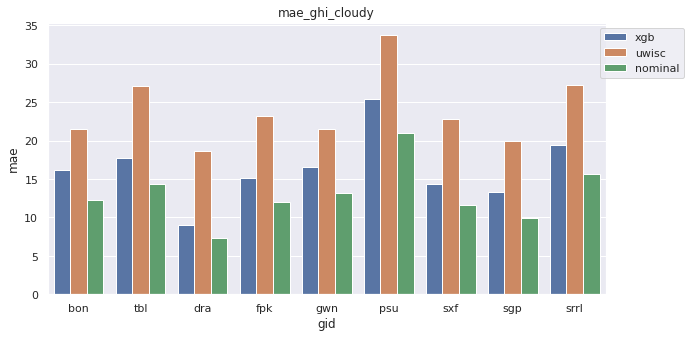

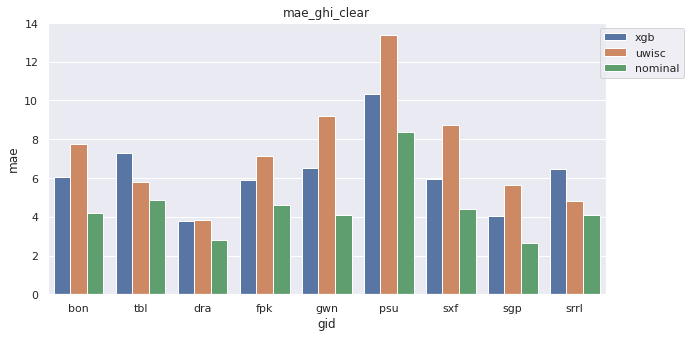

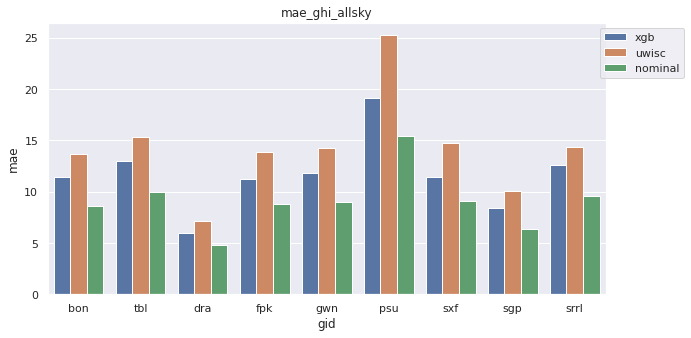

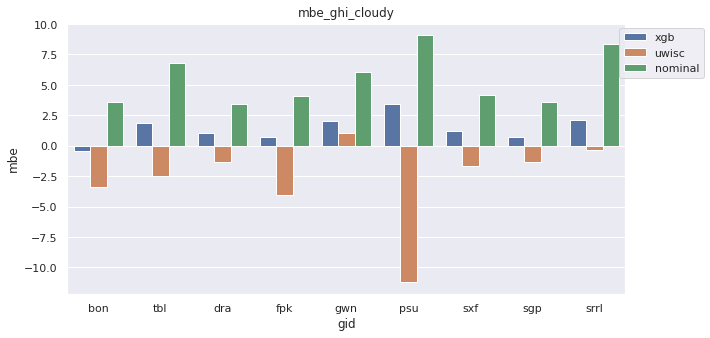

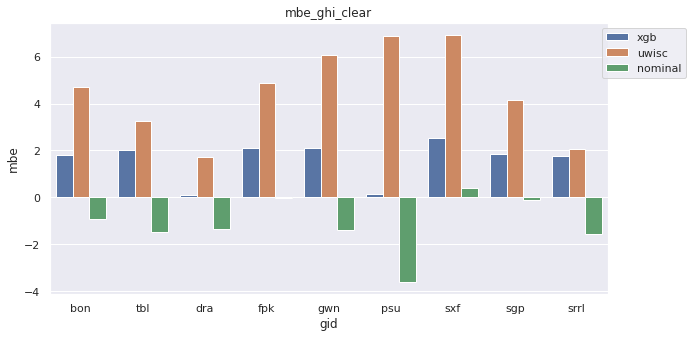

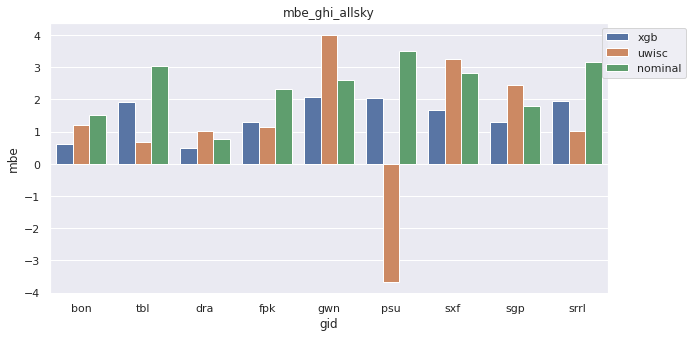

In [11]:
for metric in ('mae', 'mbe'):
    for var in ('ghi',):
        for condition in stats.condition.unique():
            mask = (stats['var'] == var) & (stats.condition == condition)

            fig = plt.figure(figsize=(10, 5))
            sns.barplot(data=stats[mask], x='gid', y=f'{metric}', hue='model', hue_order=['xgb', 'uwisc', 'nominal'])
            plt.legend(bbox_to_anchor=(1.15, 1.0))
            title = f'{metric}_{var}_{condition}'
            plt.title(title)
            
            fig.savefig(f'plots/{title}_val.png')
            plt.show()
            plt.close()

In [15]:
mask = (stats['var'] == 'ghi') & (stats['condition'] == 'cloudy')
stats[mask].sort_values('gid')

,var,condition,gid,model,mae,mbe,count
0,ghi,cloudy,bon,nominal,12.398923,3.658971,129517.0
27,ghi,cloudy,bon,uwisc,21.725045,-3.272278,102172.0
2,ghi,cloudy,dra,nominal,7.154888,3.267861,106818.0
29,ghi,cloudy,dra,uwisc,18.387430,-1.438153,56465.0
3,ghi,cloudy,fpk,nominal,11.991964,3.934702,129510.0
30,ghi,cloudy,fpk,uwisc,23.343383,-4.702008,101954.0
4,ghi,cloudy,gwn,nominal,13.087344,6.021357,128795.0
31,ghi,cloudy,gwn,uwisc,21.416458,0.791904,97018.0
32,ghi,cloudy,psu,uwisc,33.713702,-10.860329,125150.0
5,ghi,cloudy,psu,nominal,21.035742,8.972383,135445.0


In [16]:
nom_mask = ~df['nom_cloud_id'].isin(('clearsky', 'clear'))
og_mask = df['flag'].isin(('clearsky', 'clear'))
mask = nom_mask & og_mask
cols = ['surfrad_ghi', 
        'clearsky_ghi', 'ghi', 'ice_ghi', 'water_ghi', 
'cld_opd_mlclouds_water', 'cld_opd_mlclouds_ice', 
        'flag', 'nom_cloud_id',
       ]
df.loc[mask, cols].sample(30)

,surfrad_ghi,clearsky_ghi,ghi,ice_ghi,water_ghi,cld_opd_mlclouds_water,cld_opd_mlclouds_ice,flag,nom_cloud_id
2531632,711.466667,768.863564,769,740,723,0.997441,0.623487,clear,water
168649,126.400000,219.373738,219,198,219,0.271613,0.929254,clear,ice
43949,308.533333,319.718332,320,312,283,0.804875,0.465521,clear,ice
56594,12.333333,22.460055,22,19,17,0.000000,0.000000,clear,water
1211746,58.000000,126.571219,127,116,102,0.684531,0.584385,clear,water
1832616,481.142857,491.394723,491,474,447,0.737656,0.531494,clear,ice
1378365,28.600000,31.468719,31,31,23,0.000000,0.000453,clear,ice
271040,629.533333,825.491958,825,757,729,1.549358,1.027335,clear,water
1769293,413.066667,646.610617,647,615,601,1.030134,0.804360,clear,water
1629310,209.933333,233.498698,233,211,205,0.461226,0.527127,clear,ice


In [60]:
surfrad_meta

,latitude,longitude,elevation,timezone,country,state,county,urban,population,landcover,surfrad_id,gid_v3_4km,gid_full_2km
0,40.052,-88.373,213.12,-6,United States,Illinois,Champaign,NaN,75,30,bon,887015,3562898
1,40.125,-105.237,1615.50,-7,United States,Colorado,Boulder,NaN,363,140,tbl,150658,1927429
2,36.624,-116.019,990.96,-8,United States,Nevada,Nye,NaN,7,130,dra,109824,988098
3,48.308,-105.102,624.00,-7,United States,Montana,Roosevelt,NaN,0,30,fpk,249991,1939276
4,34.255,-89.873,95.28,-6,United States,Mississippi,Panola,NaN,231,50,gwn,852772,3424596
5,40.720,-77.931,377.75,-5,United States,Pennsylvania,Centre,NaN,604,50,psu,1116869,4483071
6,43.734,-96.623,479.00,-6,United States,South Dakota,Minnehaha,NaN,1283,30,sxf,706377,2838792
7,36.604,-97.485,307.95,-6,United States,Oklahoma,Grant,NaN,0,14,sgp,684607,2753907
8,39.742,-105.180,1819.60,-7,United States,Colorado,Jefferson,NaN,13486,140,srrl,145809,1931528


In [48]:
year = 2019
gid = 6
plot_mask = (pd.DatetimeIndex(df['time_index'].astype(str)).year == year) & (df['gid'] == gid)
plot_df_ground = df.loc[plot_mask, ['time_index', 'surfrad_ghi']].rename({'surfrad_ghi': 'ghi'}, axis=1)
plot_df_xgb = df.loc[plot_mask, ['time_index', 'xgb_results_ghi']].rename({'xgb_results_ghi': 'ghi'}, axis=1)
plot_df_baseline = df.loc[plot_mask, ['time_index', 'ghi']].rename({'ghi': 'ghi'}, axis=1)
plot_df_optimized = df.loc[plot_mask, ['time_index', 'nom_ghi']].rename({'nom_ghi': 'ghi'}, axis=1)
plot_df_ground['model'] = 'ground'
plot_df_baseline['model'] = 'v3+'
plot_df_optimized['model'] = 'optimized'
plot_df_xgb['model'] = 'xgb'
plot_df = plot_df_ground.append(plot_df_baseline, ignore_index=True).append(plot_df_optimized, ignore_index=True).append(plot_df_xgb, ignore_index=True)
plot_df['time_index'] = pd.to_datetime(plot_df['time_index'])
plot_df = plot_df.drop_duplicates(['time_index', 'model'])
plot_df = plot_df.sort_values(['model', 'time_index']).reset_index(drop=True)

In [49]:
plot_df

,time_index,ghi,model
0,2019-01-01 14:10:00+00:00,14.000000,ground
1,2019-01-01 14:15:00+00:00,24.800000,ground
2,2019-01-01 14:20:00+00:00,36.733333,ground
3,2019-01-01 14:25:00+00:00,46.400000,ground
4,2019-01-01 14:30:00+00:00,50.600000,ground
...,...,...,...
209043,2019-12-31 22:25:00+00:00,62.000000,xgb
209044,2019-12-31 22:30:00+00:00,39.000000,xgb
209045,2019-12-31 22:35:00+00:00,28.000000,xgb
209046,2019-12-31 22:40:00+00:00,19.000000,xgb


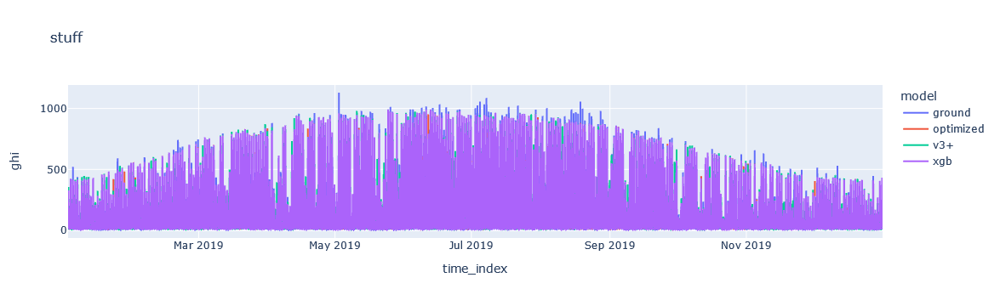

In [50]:
fig = px.line(plot_df, x="time_index", y="ghi", color='model', title='stuff')
fig.show()